### Collect data for Uber Data Analysis

In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [35]:
import os

In [36]:
files = os.listdir(r'C:\Users\moham\Documents\Bismillah\Data Science\Python Project\Project 1..Uber New York Trip-20220624T115220Z-001\Project 1..Uber New York Trip\uber-pickups-in-new-york-city')[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [37]:
files.remove('uber-raw-data-janjune-15.csv')

In [38]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [39]:
path = r'C:\Users\moham\Documents\Bismillah\Data Science\Python Project\Project 1..Uber New York Trip-20220624T115220Z-001\Project 1..Uber New York Trip\uber-pickups-in-new-york-city'

final=pd.DataFrame()

for file in files:
    df=pd.read_csv(path+'/'+file,encoding='utf-8')
    final=pd.concat([df,final])

In [40]:
final.shape

(4534327, 4)

In [41]:
df = final.copy()

In [42]:
df.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


##### Lat : The latitude of the Uber pickup

##### Lon : The longitude of the Uber pickup

##### Base : The TLC base company code affiliated with the Uber pickup

##### The globe is split into an imaginary 360 sections from both top to bottom (north to south) and 180 sections from side to side (west to east). The sections running from top to bottom on a globe are called longitude, and the sections running from side to side on a globe are called latitude.


##### Latitude is the measurement of distance north or south of the Equator.

##### Every location on earth has a global address. Because the address is in numbers, people can communicate about location no matter what language they might speak. A global address is given as two numbers called coordinates. The two numbers are a location's latitude number and its longitude number ("Lat/Long").

### Data Preparation for Uber Data Analysis

In [43]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [44]:
df['Date/Time']=pd.to_datetime(df['Date/Time'],format='%m/%d/%Y %H:%M:%S')

In [45]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


In [46]:
df['weekday']=df['Date/Time'].dt.day_name()
df['day']=df['Date/Time'].dt.day
df['minute']=df['Date/Time'].dt.minute
df['hour']=df['Date/Time'].dt.hour

In [47]:
df['month']=df['Date/Time'].dt.month

In [48]:
df['MonthName'] = df['Date/Time'].dt.month_name()

In [49]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,hour,month,MonthName
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,0,9,September
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,0,9,September
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,0,9,September
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,0,9,September
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,0,9,September


###  Analysis of Journey by Week-days

In [50]:
import plotly.express as px

In [51]:
px.bar(x=df['weekday'].value_counts().index,
       y=df['weekday'].value_counts()
      )

#### seems to have highest sales on Thursday

### Analysis of Journey by Hour

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

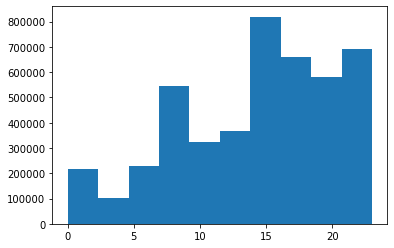

In [52]:
plt.hist(df['hour'])

#### It peaks during evening time when people are logging off from work

### Analysis of Journey by Hour each Month

In [53]:
df['month'].unique()

array([9, 5, 6, 7, 8, 4], dtype=int64)

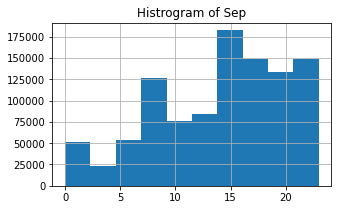

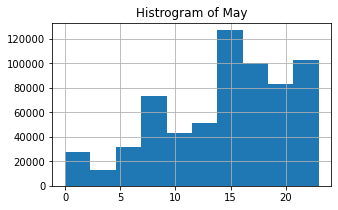

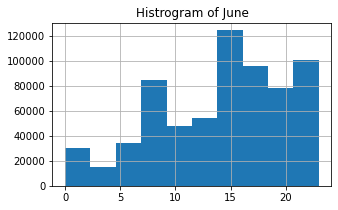

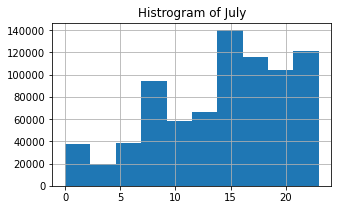

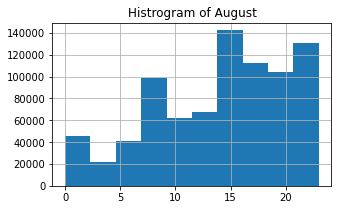

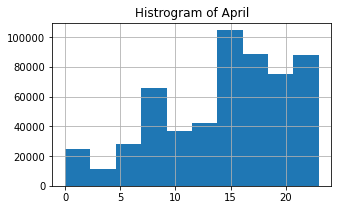

In [54]:
month={9:'Sep',5:'May',6:'June',7:'July',8:'August',4:'April'}
for i in df['month'].unique():
    plt.figure(figsize=(5,3))
    df[df['month']==i]['hour'].hist()
    plt.title('Histrogram of {}'.format(month[i]))

### Analysis of which month has max rides

In [55]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,hour,month,MonthName
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,0,9,September
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,0,9,September
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,0,9,September
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,0,9,September
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,0,9,September


In [56]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [57]:
df.groupby('MonthName')['Date/Time'].count()

MonthName
April         564516
August        829275
July          796121
June          663844
May           652435
September    1028136
Name: Date/Time, dtype: int64

In [58]:
trace1=go.Bar(
    x=df.groupby('MonthName')['Date/Time'].count().index,
    y=df.groupby('MonthName')['Date/Time'].count(),
)

In [59]:
iplot([trace1])

### Analysis of Journey of Each Day

Text(0.5, 1.0, 'Journeys by Month Day')

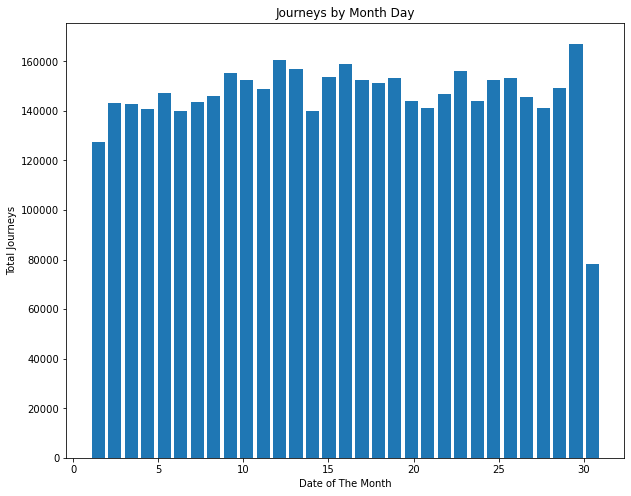

In [60]:
plt.figure(figsize=(10,8))
plt.hist(df['day'],bins=31,rwidth=0.8)
plt.xlabel('Date of The Month')
plt.ylabel('Total Journeys')
plt.title('Journeys by Month Day')

### Analysis of Total Rides month wise

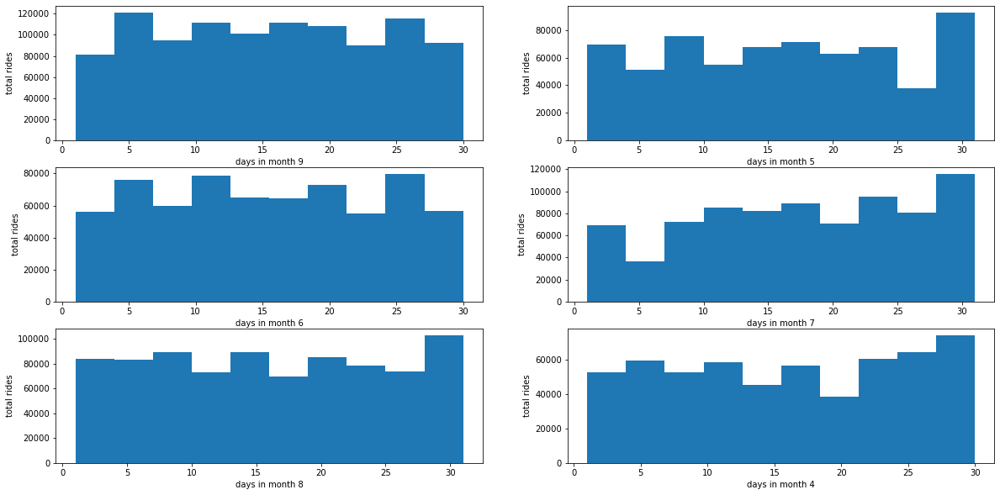

In [61]:
plt.figure(figsize=(20,10))

for i, month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out=df[df['month']==month]
    plt.hist(df_out['day'])
    plt.xlabel('days in month {}'.format(month))
    plt.ylabel('total rides')

### Analysing Rush in Hour

<AxesSubplot:xlabel='hour', ylabel='Lat'>

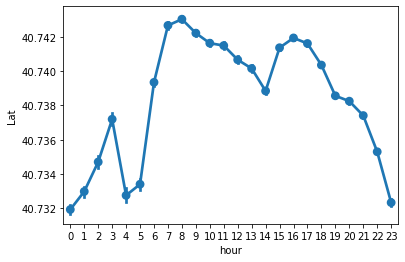

In [62]:
sns.pointplot(x='hour', y='Lat', data=df)

Text(0.5, 1.0, 'hoursoffday vs latitude of passenger')

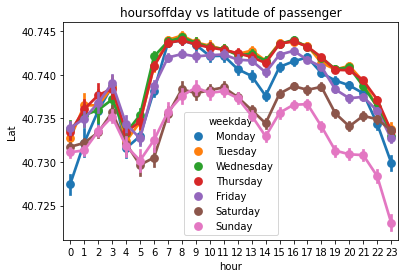

In [63]:
ax=sns.pointplot(x='hour', y='Lat', data=df, hue='weekday')
ax.set_title('hoursoffday vs latitude of passenger')

### Analyse which base number gets popular by month name?

In [64]:
base=df.groupby(['Base','month'])['Date/Time'].count().reset_index()
base.columns=['Base','month','count']
base

,Base,month,count
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='month', ylabel='count'>

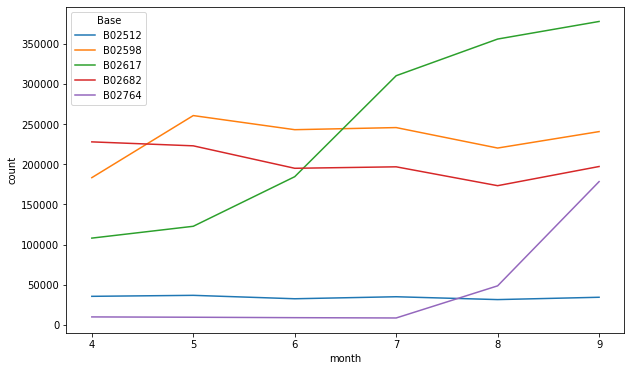

In [65]:
plt.figure(figsize=(10,6))
sns.lineplot(x='month',y='count',hue='Base',data=base)

### Perform Cross Analysis

#### Heatmap by Hour and Weekday

In [66]:
def count_rows(rows):
    return len(rows)

In [67]:
by_cross=df.groupby(['weekday','hour']).apply(count_rows)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [68]:
pivot=by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='hour', ylabel='weekday'>

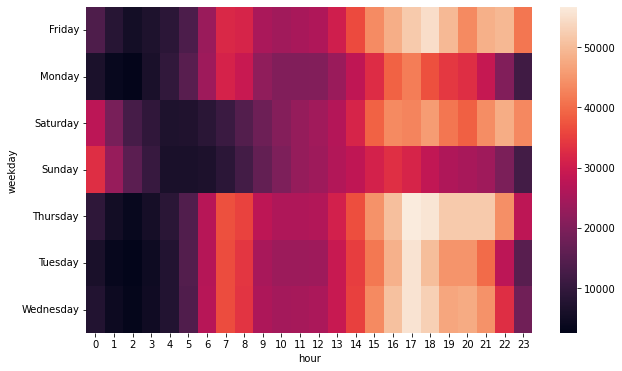

In [69]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot)

#### Heatmap by Day and Hour

In [70]:
def heatmap(col1,col2):
    by_cross=df.groupby([col1,col2]).apply(count_rows)
    pivot=by_cross.unstack()
    plt.figure(figsize=(10,6))
    sns.heatmap(pivot)

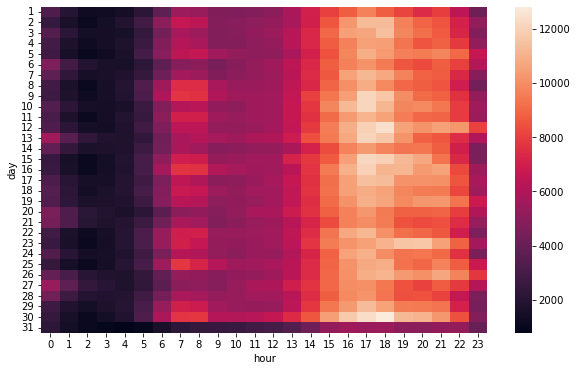

In [71]:
heatmap('day','hour')

#### Heatmap by Month and Day

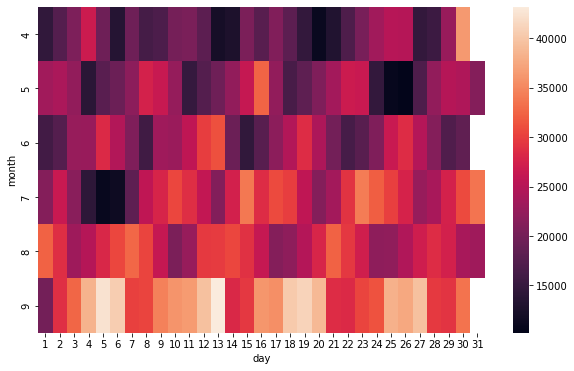

In [72]:
heatmap('month','day')

#### Heatmap by Month and Weekday

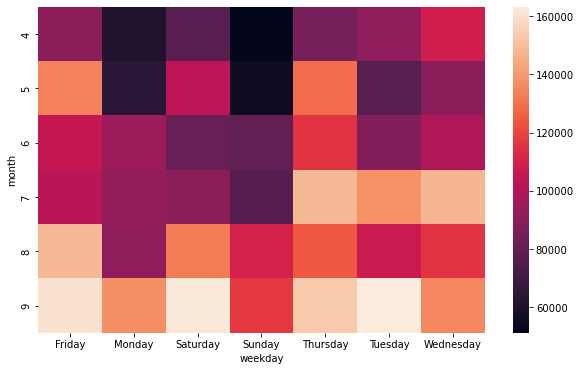

In [73]:
heatmap('month','weekday')

#### Analysing the results
#### We observe that the number of trips increases each month, we can say that from April to September 2014, Uber was in a continuous improvement process.

### Analysis of Location Data Points

(40.6, 41.0)

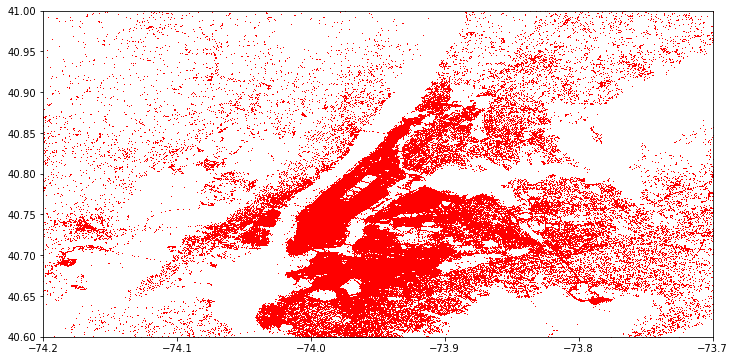

In [74]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

### Perform Spatial Analysis using Heatmap to get a clear cut of Rush

In [75]:
df_out=df[df['weekday']=='Sunday']

In [76]:
df_out.shape

(490180, 10)

In [77]:
df_out.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,hour,month,MonthName
8011,2014-09-07 00:00:00,40.7341,-74.0005,B02512,Sunday,7,0,0,9,September
8012,2014-09-07 00:00:00,40.7344,-73.9900,B02512,Sunday,7,0,0,9,September
8013,2014-09-07 00:00:00,40.7806,-73.9582,B02512,Sunday,7,0,0,9,September
8014,2014-09-07 00:01:00,40.7293,-73.9859,B02512,Sunday,7,1,0,9,September
8015,2014-09-07 00:01:00,40.7713,-74.0133,B02512,Sunday,7,1,0,9,September


In [78]:
rush=df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()

In [79]:
rush.columns=['Lat','Lon','no of trips']
rush

,Lat,Lon,no of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


#### Install Folium 

In [51]:
!pip install folium

In [80]:
from folium.plugins import HeatMap

In [81]:
import folium

In [82]:
basemap=folium.Map()

In [83]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap

### Automate Spatial Analysis 

In [84]:
def plot(df,day):
    basemap=folium.Map()
    df_out=df[df['weekday']==day]
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [85]:
plot(df,'Saturday')

In [86]:
def plot(day):
    df_out=df[df['weekday']==day]
    df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [87]:
plot('Saturday')

# Analysis of Jan-June uber_15

## Data Preparation

In [88]:
uber_15=pd.read_csv(r'C:\Users\moham\Documents\Bismillah\Data Science\Python Project\Project 1..Uber New York Trip-20220624T115220Z-001\Project 1..Uber New York Trip\uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv')

In [89]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [90]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [91]:
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'],format='%Y-%m-%d %H:%M:%S')

In [92]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [93]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['minute']=uber_15['Pickup_date'].dt.minute
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['hour']=uber_15['Pickup_date'].dt.hour

In [94]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,5,9


## Uber pickups by month in NYC

In [95]:
uber_15.groupby('month')['hour'].count()

month
1    1953801
2    2263620
3    2259773
4    2280837
5    2695553
6    2816895
Name: hour, dtype: int64

In [96]:
uber_15['month'].value_counts()

6    2816895
5    2695553
4    2280837
2    2263620
3    2259773
1    1953801
Name: month, dtype: int64

In [97]:
px.bar(x=uber_15['month'].value_counts().index,
       y=uber_15['month'].value_counts())

#### We can see that the number of Uber pickup has been steadily increasing throughout the first half of 2015 in NYC

### Analysing Rush in New York City

C:\Users\moham\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='hour', ylabel='count'>

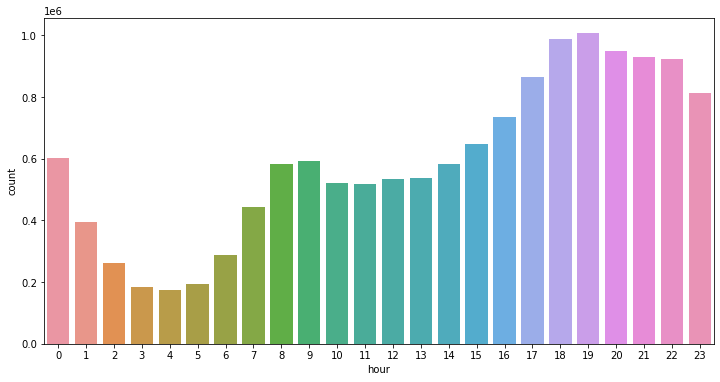

In [98]:
plt.figure(figsize=(12,6))
sns.countplot(uber_15['hour'])

##### Interestingly, after the morning rush, the number of Uber pickups doesn't dip much throughout the rest of the morning and early afternoon. There is significantly more demand in the evening than the daytime. Let's investigate to see if there's a difference in hourly pattern for different days of the week.

### Analysing In-Depth Analysis of Rush in New York City Day & Hour wise

In [99]:
summary=uber_15.groupby(['weekday','hour'])['Pickup_date'].count().reset_index()
summary.head()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [100]:
summary.columns=['weekday', 'hour', 'counts']
summary.head()

,weekday,hour,counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<AxesSubplot:xlabel='hour', ylabel='counts'>

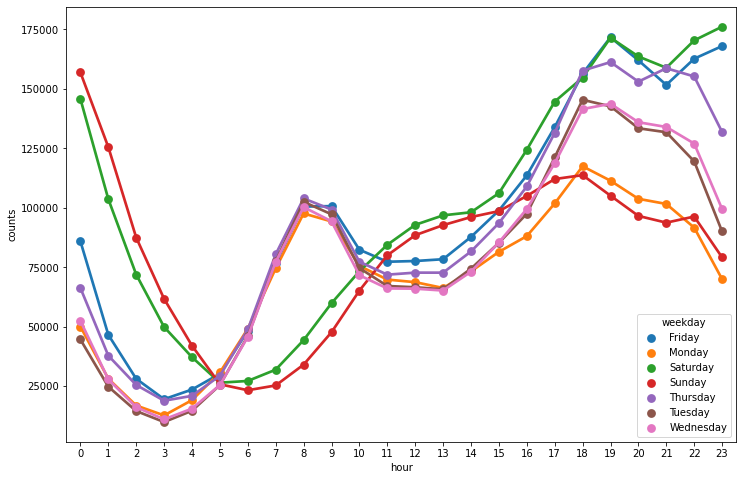

In [101]:
plt.figure(figsize=(12,8))
sns.pointplot(x='hour',y='counts',hue='weekday',data=summary)

## Loading Uber-Jan-Feb-FOIL.csv

In [102]:
uber_foil=pd.read_csv(r'C:\Users\moham\Documents\Bismillah\Data Science\Python Project\Project 1..Uber New York Trip-20220624T115220Z-001\Project 1..Uber New York Trip\uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv')
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [103]:
uber_foil.shape

(354, 4)

### Analysing which base number has most active vehicles

In [104]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

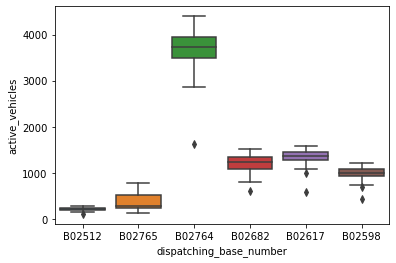

In [105]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil)

#### seems to have more number of Active Vehicles in B02764

### Analysing which base number has most trip

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

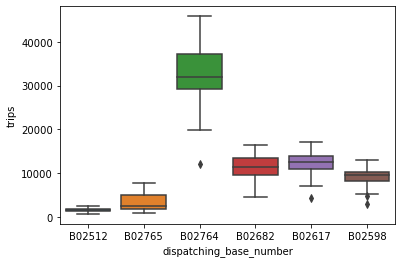

In [106]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil)

#### seems to have more number of trips in B02764

### How average trips/vehicle increase/decrease with dates with each of base number

In [107]:
uber_foil['trips/vehicle']=uber_foil['trips']/uber_foil['active_vehicles']
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


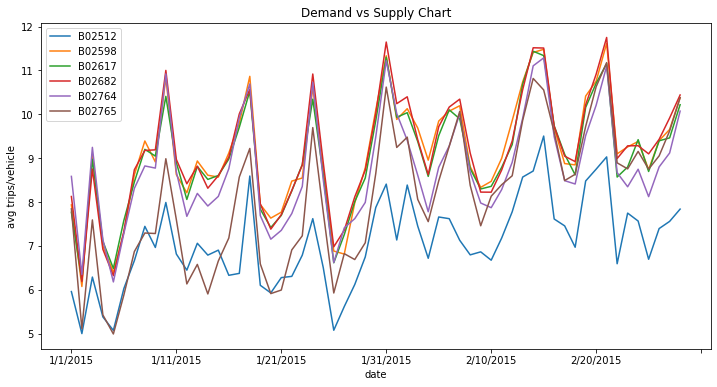

In [108]:
plt.figure(figsize=(12,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('avg trips/vehicle')
plt.title('Demand vs Supply Chart')
plt.legend()